In [ ]:
# BLOCK 1: Imports, config, paths (CPU-only)
import os, glob, random, numpy as np, pandas as pd, cv2, torch, torch.nn as nn
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import roc_auc_score, confusion_matrix, accuracy_score, recall_score, precision_recall_curve, roc_curve
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
import timm
import torchvision.transforms as T
from PIL import Image

# Reproducibility (CPU)
SEED = 42
random.seed(SEED); np.random.seed(SEED); torch.manual_seed(SEED)

# Force CPU
DEVICE = torch.device("cpu")
print("Device:", DEVICE)

# Paths (Drive mounted manually as stated)
BASE = "/content/drive/MyDrive/data/FinalRetino"
CSV_PATH = "/content/drive/MyDrive/data/FinalRetino/Annotation.csv"

# Hyperparameters (CPU-friendly)
IMG_SIZE = 256
BATCH_SIZE = 16
FOLDS = 5
EPOCHS = 10
PATIENCE = 3
LR = 1e-4
WEIGHT_DECAY = 1e-4
MODEL_NAME = "efficientnet_b0"


Device: cpu


In [ ]:
# BLOCK 2: DataFrame and filepath resolution (correct splitext)
df = pd.read_csv(CSV_PATH).rename(columns={'Image':'filename','Label':'label'})
df['filename'] = df['filename'].astype(str).str.strip()
df['label'] = df['label'].astype(int)

roots = [BASE] + [d for d in glob.glob(os.path.join(BASE, "*")) if os.path.isdir(d)]

# Detect extensions present under BASE
all_files = glob.glob(os.path.join(BASE, "**", "*.*"), recursive=True)
exts_present = sorted({
    os.path.splitext(p)[1].lower()   # <-- FIX: only extension part
    for p in all_files
    if os.path.splitext(p)[1]        # skip files without extension
})
exts_try = exts_present if exts_present else [".jpg", ".jpeg", ".png", ".bmp", ".tif", ".tiff"]
print("Extensions tried:", exts_try[:10])

# Optional class-like subfolders
class_dirs = {}
for d in roots:
    n = os.path.basename(d).lower()
    if n in ["normal","rb","positive","negative","tumor","healthy"]:
        class_dirs[n] = d

label_map = {0:["normal","negative","healthy"], 1:["rb","positive","tumor"]}

def candidates(stem, label):
    c = []
    # Case 1: stem already has an extension in CSV
    base, ext = os.path.splitext(stem)
    if ext:  # keep as-is
        for r in roots:
            c.append(os.path.join(r, stem))
    else:  # Case 2: try adding possible extensions
        for r in roots:
            for e in exts_try:
                c.append(os.path.join(r, f"{stem}{e}"))
        # Case 3: also try class subfolders
        for tag in label_map.get(int(label), []):
            if tag in class_dirs:
                for e in exts_try:
                    c.append(os.path.join(class_dirs[tag], f"{stem}{e}"))
    return c

def resolve_one(stem, label):
    for p in candidates(stem, label):
        if os.path.exists(p):
            return p
    return None

df['filepath'] = [resolve_one(stem, lab) for stem, lab in zip(df['filename'], df['label'])]
missing = df[df['filepath'].isna()]
assert missing.empty, f"Unresolved files: {len(missing)}"
print("Resolved examples:", df.head(5).to_dict(orient='records'))
print("Resolved:", df['filepath'].notna().sum(), "of", len(df))


Extensions tried: ['.csv', '.jpg']
Resolved examples: [{'filename': '1', 'label': 1, 'filepath': '/content/drive/MyDrive/data/FinalRetino/1.jpg'}, {'filename': '2', 'label': 1, 'filepath': '/content/drive/MyDrive/data/FinalRetino/2.jpg'}, {'filename': '3', 'label': 1, 'filepath': '/content/drive/MyDrive/data/FinalRetino/3.jpg'}, {'filename': '4', 'label': 1, 'filepath': '/content/drive/MyDrive/data/FinalRetino/4.jpg'}, {'filename': '5', 'label': 1, 'filepath': '/content/drive/MyDrive/data/FinalRetino/5.jpg'}]
Resolved: 280 of 280


In [ ]:
# BLOCK 3: Transforms and Dataset (torchvision only)
train_tfms = T.Compose([
    T.Resize(IMG_SIZE, interpolation=T.InterpolationMode.BILINEAR),
    T.CenterCrop(IMG_SIZE),
    T.RandomHorizontalFlip(p=0.5),
    T.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.05),
    T.ToTensor(),
    T.Normalize(mean=(0.485,0.456,0.406), std=(0.229,0.224,0.225)),
])

valid_tfms = T.Compose([
    T.Resize(IMG_SIZE, interpolation=T.InterpolationMode.BILINEAR),
    T.CenterCrop(IMG_SIZE),
    T.ToTensor(),
    T.Normalize(mean=(0.485,0.456,0.406), std=(0.229,0.224,0.225)),
])

class ImageCSVDataset(Dataset):
    def __init__(self, df, transforms):
        self.df = df.reset_index(drop=True)
        self.transforms = transforms

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        img = Image.open(row.filepath).convert("RGB")
        tensor = self.transforms(img)
        # return label as shape (1,) instead of scalar
        label = torch.tensor([int(row.label)], dtype=torch.float32)
        return tensor, label


In [ ]:
# BLOCK 4: Model, optimizer, loaders
def build_model():
    # Binary classification → 1 output logit
    model = timm.create_model(MODEL_NAME, pretrained=True, num_classes=1)
    return model.to(DEVICE)

def get_loss_weights(labels_np):
    # For BCEWithLogitsLoss (pos_weight parameter)
    pos = (labels_np == 1).sum()
    neg = (labels_np == 0).sum()
    pos_weight = neg / max(pos, 1)
    return torch.tensor([pos_weight], dtype=torch.float32, device=DEVICE)

def get_optimizer(model):
    return torch.optim.AdamW(model.parameters(), lr=LR, weight_decay=WEIGHT_DECAY)

def make_sampler(labels):
    counts = np.bincount(labels.astype(int))
    weights_per_class = 1.0 / np.maximum(counts, 1)
    example_weights = [weights_per_class[y] for y in labels.astype(int)]
    return WeightedRandomSampler(example_weights, num_samples=len(example_weights), replacement=True)

def make_loader(df_fold, transforms, train=True, sampler=None):
    ds = ImageCSVDataset(df_fold, transforms)
    if train:
        if sampler is not None:
            return DataLoader(ds, batch_size=BATCH_SIZE, sampler=sampler, num_workers=4, pin_memory=True)
        else:
            return DataLoader(ds, batch_size=BATCH_SIZE, shuffle=True, num_workers=4, pin_memory=True)
    else:
        return DataLoader(ds, batch_size=BATCH_SIZE, shuffle=False, num_workers=4, pin_memory=True)


In [ ]:
# BLOCK 5: Training and evaluation (CPU)

def train_one_epoch(model, loader, criterion, optimizer):
    model.train()
    total, loss_sum = 0, 0.0
    for imgs, labels in loader:
        imgs = imgs.to(DEVICE)             # (B, C, H, W)
        labels = labels.to(DEVICE)         # already (B, 1) from Dataset
        logits = model(imgs)               # (B, 1)
        loss = criterion(logits, labels)   # shapes match

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        loss_sum += loss.item() * imgs.size(0)
        total += imgs.size(0)
    return loss_sum / max(total, 1)


@torch.no_grad()
def eval_epoch(model, loader):
    model.eval()
    logits_all, labels_all = [], []

    for imgs, labels in loader:
        imgs = imgs.to(DEVICE)
        labels = labels.to(DEVICE)         # (B, 1)
        logits = model(imgs)               # (B, 1)
        logits_all.append(logits.detach().cpu())
        labels_all.append(labels.detach().cpu())

    logits_all = torch.cat(logits_all).squeeze(1)  # (N,)
    labels_all = torch.cat(labels_all).squeeze(1)  # (N,)

    probs = torch.sigmoid(logits_all).numpy()
    y_true = labels_all.numpy().astype(int)
    y_pred = (probs >= 0.5).astype(int)

    auc = roc_auc_score(y_true, probs) if len(np.unique(y_true)) > 1 else float("nan")
    acc = accuracy_score(y_true, y_pred)
    sens = recall_score(y_true, y_pred, pos_label=1)

    cm = confusion_matrix(y_true, y_pred, labels=[0, 1])
    if cm.shape == (2, 2):
        tn, fp, fn, tp = cm.ravel()
    else:
        tn = cm[0, 0] if y_true.max() == 0 else 0
        fp = fn = tp = 0

    spec = tn / (tn + fp + 1e-9)
    return {"AUC": auc, "ACC": acc, "SENS": sens, "SPEC": spec}


# Cross-validation loop
skf = StratifiedKFold(n_splits=FOLDS, shuffle=True, random_state=SEED)
fold_metrics = []

for fold, (tr_idx, va_idx) in enumerate(skf.split(df['filepath'], df['label']), 1):
    print(f"\n===== Fold {fold}/{FOLDS} =====")
    df_tr = df.iloc[tr_idx].copy().reset_index(drop=True)
    df_va = df.iloc[va_idx].copy().reset_index(drop=True)

    sampler = make_sampler(df_tr['label'].values)
    train_loader = make_loader(df_tr, train_tfms, train=True, sampler=sampler)
    valid_loader = make_loader(df_va, valid_tfms, train=False)

    model = build_model()
    criterion = nn.BCEWithLogitsLoss(pos_weight=get_loss_weights(df_tr['label'].values))
    optimizer = get_optimizer(model)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=EPOCHS)

    best_auc, no_improve = -1.0, 0
    best_path = f"/content/best_fold{fold}.pt"

    for epoch in range(1, EPOCHS + 1):
        tr_loss = train_one_epoch(model, train_loader, criterion, optimizer)
        val_metrics = eval_epoch(model, valid_loader)
        scheduler.step()

        print(f"Epoch {epoch:02d} | loss {tr_loss:.4f} | "
              f"AUC {val_metrics['AUC']:.4f} | "
              f"ACC {val_metrics['ACC']:.4f} | "
              f"SENS {val_metrics['SENS']:.4f} | "
              f"SPEC {val_metrics['SPEC']:.4f}")

        if val_metrics["AUC"] > best_auc:
            best_auc = val_metrics["AUC"]
            torch.save(model.state_dict(), best_path)
            no_improve = 0
        else:
            no_improve += 1
            if no_improve >= PATIENCE:
                print("Early stopping.")
                break

    model.load_state_dict(torch.load(best_path, map_location=DEVICE))
    fold_metrics.append(eval_epoch(model, valid_loader))

agg = {k: np.nanmean([m[k] for m in fold_metrics]) for k in ["AUC","ACC","SENS","SPEC"]}
print("\nCV Mean:", agg)



===== Fold 1/5 =====


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


Epoch 01 | loss 0.8778 | AUC 0.9949 | ACC 0.9286 | SENS 0.8571 | SPEC 1.0000


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


Epoch 02 | loss 0.0419 | AUC 1.0000 | ACC 0.9821 | SENS 1.0000 | SPEC 0.9643


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


Epoch 03 | loss 0.0211 | AUC 1.0000 | ACC 0.9821 | SENS 1.0000 | SPEC 0.9643


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


Epoch 04 | loss 0.0303 | AUC 1.0000 | ACC 1.0000 | SENS 1.0000 | SPEC 1.0000


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


Epoch 05 | loss 0.0272 | AUC 1.0000 | ACC 1.0000 | SENS 1.0000 | SPEC 1.0000
Early stopping.


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)



===== Fold 2/5 =====


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


Epoch 01 | loss 0.5682 | AUC 0.9911 | ACC 0.9286 | SENS 0.8929 | SPEC 0.9643


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


Epoch 02 | loss 0.0104 | AUC 0.9987 | ACC 0.9821 | SENS 1.0000 | SPEC 0.9643


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


Epoch 03 | loss 0.0342 | AUC 0.9974 | ACC 0.9821 | SENS 1.0000 | SPEC 0.9643


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


Epoch 04 | loss 0.0413 | AUC 1.0000 | ACC 0.9821 | SENS 1.0000 | SPEC 0.9643


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


Epoch 05 | loss 0.0143 | AUC 1.0000 | ACC 0.9821 | SENS 1.0000 | SPEC 0.9643


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


Epoch 06 | loss 0.0038 | AUC 1.0000 | ACC 0.9821 | SENS 1.0000 | SPEC 0.9643


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


Epoch 07 | loss 0.0015 | AUC 1.0000 | ACC 1.0000 | SENS 1.0000 | SPEC 1.0000
Early stopping.


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)



===== Fold 3/5 =====


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


Epoch 01 | loss 0.6078 | AUC 0.9949 | ACC 0.9643 | SENS 0.9286 | SPEC 1.0000


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


Epoch 02 | loss 0.1095 | AUC 1.0000 | ACC 1.0000 | SENS 1.0000 | SPEC 1.0000


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


Epoch 03 | loss 0.0443 | AUC 1.0000 | ACC 1.0000 | SENS 1.0000 | SPEC 1.0000


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


Epoch 04 | loss 0.0030 | AUC 1.0000 | ACC 1.0000 | SENS 1.0000 | SPEC 1.0000


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


Epoch 05 | loss 0.0004 | AUC 1.0000 | ACC 1.0000 | SENS 1.0000 | SPEC 1.0000
Early stopping.


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)



===== Fold 4/5 =====


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


Epoch 01 | loss 1.5494 | AUC 1.0000 | ACC 0.9464 | SENS 0.8929 | SPEC 1.0000


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


Epoch 02 | loss 0.1160 | AUC 1.0000 | ACC 1.0000 | SENS 1.0000 | SPEC 1.0000


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


Epoch 03 | loss 0.0311 | AUC 1.0000 | ACC 1.0000 | SENS 1.0000 | SPEC 1.0000


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


Epoch 04 | loss 0.0206 | AUC 1.0000 | ACC 1.0000 | SENS 1.0000 | SPEC 1.0000
Early stopping.


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)



===== Fold 5/5 =====


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


Epoch 01 | loss 0.2563 | AUC 1.0000 | ACC 0.9643 | SENS 0.9286 | SPEC 1.0000


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


Epoch 02 | loss 0.0069 | AUC 1.0000 | ACC 1.0000 | SENS 1.0000 | SPEC 1.0000


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


Epoch 03 | loss 0.0907 | AUC 1.0000 | ACC 1.0000 | SENS 1.0000 | SPEC 1.0000


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


Epoch 04 | loss 0.0395 | AUC 1.0000 | ACC 1.0000 | SENS 1.0000 | SPEC 1.0000
Early stopping.


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)



CV Mean: {'AUC': np.float64(1.0), 'ACC': np.float64(0.975), 'SENS': np.float64(0.9642857142857142), 'SPEC': np.float64(0.9857142856790816)}


In [ ]:
# BLOCK 6: Threshold tuning (OOF)

all_probs, all_true = [], []
skf = StratifiedKFold(n_splits=FOLDS, shuffle=True, random_state=SEED)

for fold, (tr_idx, va_idx) in enumerate(skf.split(df['filepath'], df['label']), 1):
    df_va = df.iloc[va_idx].copy().reset_index(drop=True)
    valid_loader = make_loader(df_va, valid_tfms, train=False)

    # load best model for this fold
    model = build_model()
    model.load_state_dict(torch.load(f"/content/best_fold{fold}.pt", map_location=DEVICE))
    model.eval()

    fold_probs = []
    with torch.no_grad():
        for imgs, _ in valid_loader:
            imgs = imgs.to(DEVICE)
            logits = model(imgs)                     # (B, 1)
            p = torch.sigmoid(logits).squeeze(1)     # (B,)
            fold_probs.append(p.cpu().numpy())

    all_probs.append(np.concatenate(fold_probs))
    all_true.append(df_va['label'].values.astype(int))

# Flatten across folds
all_probs = np.concatenate(all_probs)
all_true = np.concatenate(all_true)

# --- Find optimal thresholds ---
prec, rec, thr_pr = precision_recall_curve(all_true, all_probs)
f1 = 2 * prec * rec / (prec + rec + 1e-9)
thr_best_pr = thr_pr[max(np.nanargmax(f1) - 1, 0)] if len(thr_pr) > 0 else 0.5

fpr, tpr, thr_roc = roc_curve(all_true, all_probs)
youden = tpr - fpr
thr_best_roc = thr_roc[np.nanargmax(youden)]

# --- Eval helper ---
def eval_thr(y_true, y_prob, thr):
    y_pred = (y_prob >= thr).astype(int)
    auc = roc_auc_score(y_true, y_prob)
    acc = accuracy_score(y_true, y_pred)
    sens = recall_score(y_true, y_pred, pos_label=1)
    tn, fp, fn, tp = confusion  _matrix(y_true, y_pred, labels=[0, 1]).ravel()
    spec = tn / (tn + fp + 1e-9)
    return dict(threshold=float(thr), AUC=auc, ACC=acc, SENS=sens, SPEC=spec)

# --- Report ---
print("Default 0.5:", eval_thr(all_true, all_probs, 0.5))
print("PR-F1 optimal:", eval_thr(all_true, all_probs, thr_best_pr))
print("ROC-Youden:", eval_thr(all_true, all_probs, thr_best_roc))


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


Default 0.5: {'threshold': 0.5, 'AUC': 0.9986224489795917, 'ACC': 0.975, 'SENS': 0.9642857142857143, 'SPEC': np.float64(0.985714285707245)}
PR-F1 optimal: {'threshold': 0.0014071445912122726, 'AUC': 0.9986224489795917, 'ACC': 0.9857142857142858, 'SENS': 1.0, 'SPEC': np.float64(0.9714285714216327)}
ROC-Youden: {'threshold': 0.0755896046757698, 'AUC': 0.9986224489795917, 'ACC': 0.9892857142857143, 'SENS': 0.9928571428571429, 'SPEC': np.float64(0.985714285707245)}


1.jpg -> prob: 1.0 pred: 1


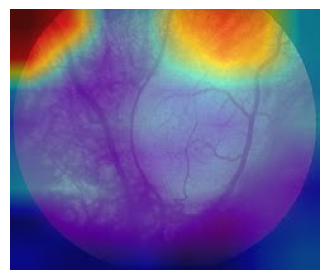

2.jpg -> prob: 1.0 pred: 1


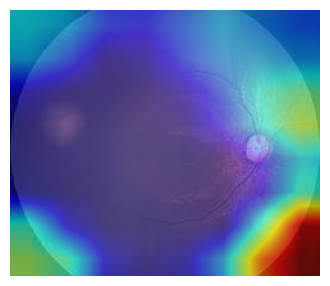

3.jpg -> prob: 1.0 pred: 1


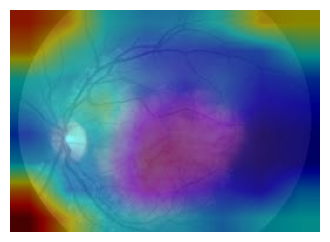

In [ ]:
# BLOCK 7: Grad-CAM (no targets for single-logit)
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.image import show_cam_on_image
import matplotlib.pyplot as plt
import cv2

best_model = build_model()
best_model.load_state_dict(torch.load("/content/best_fold1.pt", map_location=DEVICE))
best_model.eval()

# Choose a valid conv target layer for timm EfficientNet-B0
try:
    target_layers = [best_model.get_submodule("blocks")[-1]]
except Exception:
    try:
        target_layers = [best_model.get_submodule("blocks.6")]
    except Exception:
        target_layers = [best_model.get_submodule("conv_head")]

def gradcam_image_no_targets(img_path, thr=0.5):
    pil = Image.open(img_path).convert("RGB")
    rgb = np.array(pil)
    rgb_float = rgb.astype(np.float32) / 255.0
    tensor = valid_tfms(pil).unsqueeze(0).to(DEVICE)

    with torch.no_grad():
        logit = best_model(tensor)
        prob = torch.sigmoid(logit).item()
        pred_cls = int(prob >= thr)

    # GradCAM without "use_cuda"
    cam = GradCAM(model=best_model, target_layers=target_layers)
    grayscale_cam = cam(input_tensor=tensor)[0]  # first in batch

    # Resize CAM to match image
    H, W = rgb.shape[:2]
    grayscale_cam = cv2.resize(grayscale_cam, (W, H))

    vis = show_cam_on_image(rgb_float, grayscale_cam, use_rgb=True)
    return prob, pred_cls, vis

# Visualize a few images
for p in df['filepath'].head(3).tolist():
    prob, pred, vis = gradcam_image_no_targets(p)
    print(os.path.basename(p), "-> prob:", round(prob, 3), "pred:", pred)
    plt.figure(figsize=(4, 4))
    plt.imshow(vis)
    plt.axis("off")
    plt.show()


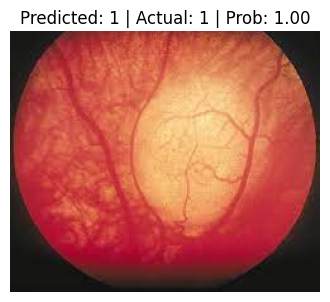

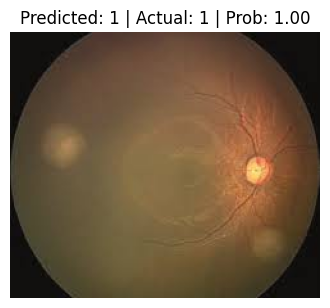

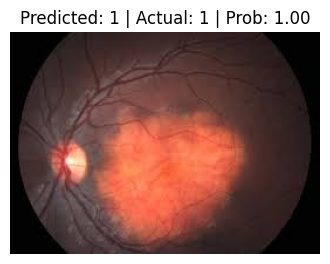

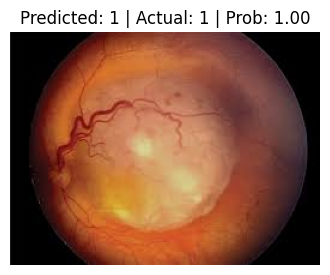

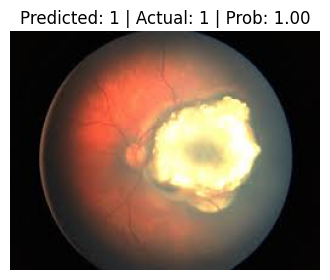

...

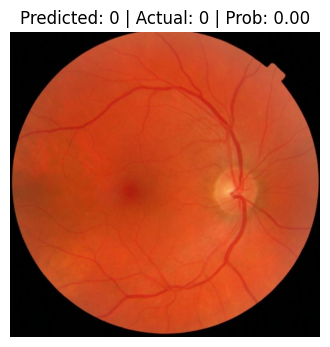

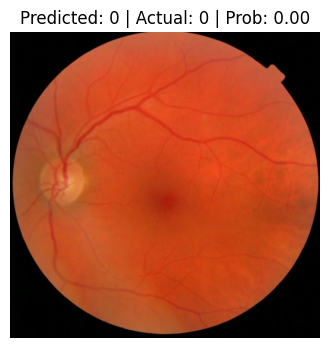

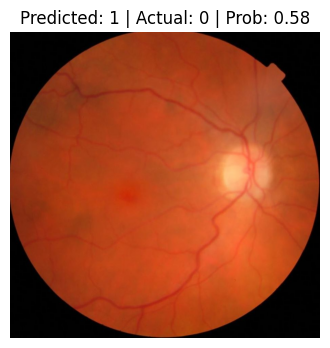

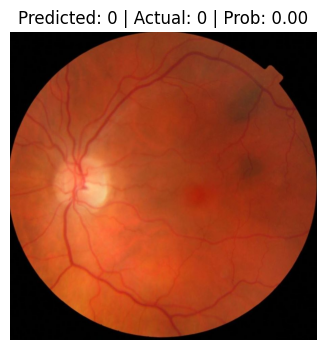

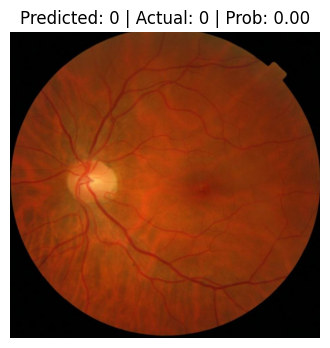

In [ ]:
# BLOCK 9: Display images with predictions
import pandas as pd
import numpy as np
import torch
from PIL import Image
import matplotlib.pyplot as plt
import os

# ==== Paths ====
BASE = "/content/drive/MyDrive/data/FinalRetino"
CSV_PATH = "/content/drive/MyDrive/data/FinalRetino/Annotation.csv"
MODEL_PATH = "/content/best_fold1.pt"

# ==== Load CSV ====
df = pd.read_csv(CSV_PATH).rename(columns={'Image':'filename','Label':'label'})
df['filename'] = df['filename'].astype(str).str.strip()
df['label'] = df['label'].astype(int)

# Resolve full paths
def resolve_path(fname):
    for ext in [".jpg", ".jpeg", ".png", ".bmp", ".tif", ".tiff"]:
        cand = os.path.join(BASE, fname + ext)
        if os.path.exists(cand):
            return cand
        cand2 = os.path.join(BASE, fname)
        if os.path.exists(cand2):
            return cand2
    return None

df['filepath'] = [resolve_path(f) for f in df['filename']]
missing = df[df['filepath'].isna()]
assert missing.empty, f"Unresolved files: {len(missing)}"

# ==== Load model ====
model = build_model()
model.load_state_dict(torch.load(MODEL_PATH, map_location=DEVICE))
model.eval()

# ==== Inference + display ====
for idx, row in df.iterrows():
    img = Image.open(row['filepath']).convert("RGB")
    input_tensor = valid_tfms(img).unsqueeze(0).to(DEVICE)

    with torch.no_grad():
        logit = model(input_tensor)
        prob = torch.sigmoid(logit).item()
        pred = int(prob >= 0.5)

    # Display image
    plt.figure(figsize=(4,4))
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Predicted: {pred} | Actual: {row['label']} | Prob: {prob:.2f}")
    plt.show()


In [ ]:
import shutil
import os

# Path where your folds were saved
fold_model_paths = [f"/content/best_fold{i}.pt" for i in range(1,6)]

# Target folder in Google Drive
TARGET_DIR = "/content/drive/MyDrive/data/FinalRetino/Models"
os.makedirs(TARGET_DIR, exist_ok=True)

for path in fold_model_paths:
    if os.path.exists(path):
        shutil.copy(path, TARGET_DIR)
        print(f"Saved {path} -> {TARGET_DIR}")
    else:
        print(f"Model not found: {path}")


Saved /content/best_fold1.pt -> /content/drive/MyDrive/data/FinalRetino/Models
Saved /content/best_fold2.pt -> /content/drive/MyDrive/data/FinalRetino/Models
Saved /content/best_fold3.pt -> /content/drive/MyDrive/data/FinalRetino/Models
Saved /content/best_fold4.pt -> /content/drive/MyDrive/data/FinalRetino/Models
Saved /content/best_fold5.pt -> /content/drive/MyDrive/data/FinalRetino/Models


In [ ]:
import os
import zipfile
from google.colab import files  # <-- important

# Paths to your fold models
fold_model_paths = [f"/content/best_fold{i}.pt" for i in range(1,6)]

# Create zip
zip_path = "/content/FinalRetino_Models.zip"
with zipfile.ZipFile(zip_path, 'w') as zipf:
    for model_path in fold_model_paths:
        if os.path.exists(model_path):
            zipf.write(model_path, os.path.basename(model_path))
            print(f"Added {model_path} to zip")
        else:
            print(f"Model not found: {model_path}")

# Download zip
files.download(zip_path)


Added /content/best_fold1.pt to zip
Added /content/best_fold2.pt to zip
Added /content/best_fold3.pt to zip
Added /content/best_fold4.pt to zip
Added /content/best_fold5.pt to zip


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>